# PDF and Images Content Extraction for Large Language Models

In [1]:
pip install -U pypdfium2 matplotlib easyocr ragstack-ai certifi PyPDF2 pdf2image pdfminer pdfminer.six pillow_heif pikepdf pypdf google-cloud-aiplatform


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pypdfium2 as pdfium
import matplotlib.pyplot as plt
from PIL import Image as PIL_Image
from io import BytesIO

In [4]:
def convert_pdf_to_images(file_path, scale=300/72):
    
    pdf_file = pdfium.PdfDocument(file_path)  
    page_indices = [i for i in range(len(pdf_file))]
    
    renderer = pdf_file.render(
        pdfium.PdfBitmap.to_pil,
        page_indices = page_indices, 
        scale = scale,
    )
    
    list_final_images = [] 
    
    for i, image in zip(page_indices, renderer):
        
        image_byte_array = BytesIO()
        image.save(image_byte_array, format='jpeg', optimize=True)
        image_byte_array = image_byte_array.getvalue()
        list_final_images.append(dict({i:image_byte_array}))
    
    return list_final_images

In [5]:
def display_images(list_dict_final_images):
    
    all_images = [list(data.values())[0] for data in list_dict_final_images]

    for index, image_bytes in enumerate(all_images):

        image = PIL_Image.open(BytesIO(image_bytes))
        figure = plt.figure(figsize = (image.width / 100, image.height / 100))

        plt.title(f"----- Page Number {index+1} -----")
        plt.imshow(image)
        plt.axis("off")
        plt.show()

In [6]:
convert_pdf_to_images = convert_pdf_to_images('SellingInvoices.pdf')

In [8]:
#convert_pdf_to_images

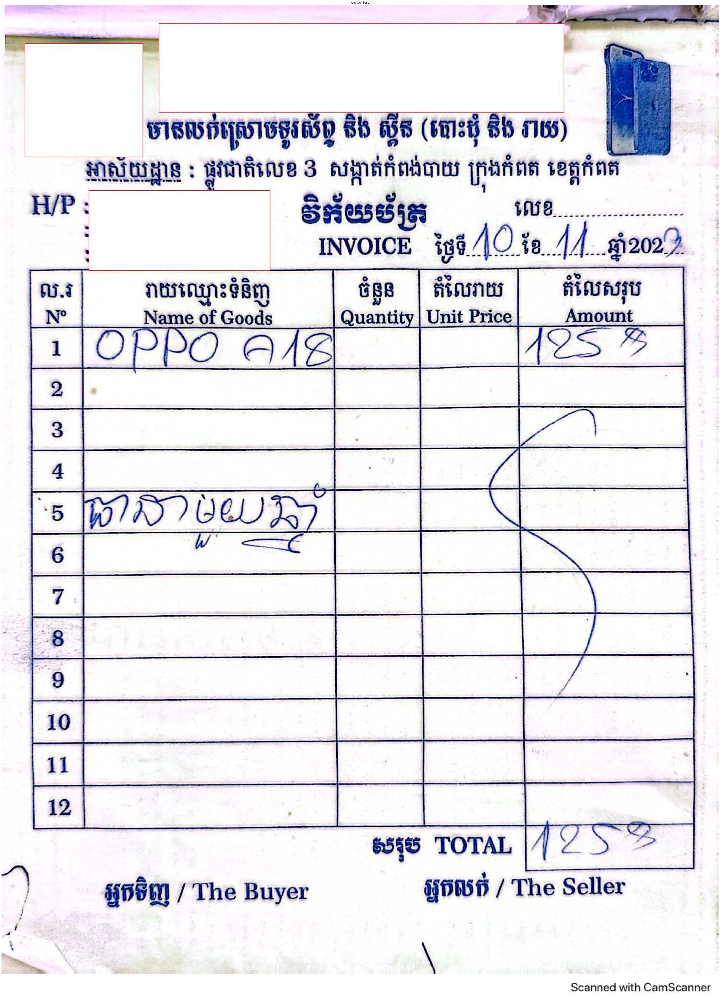

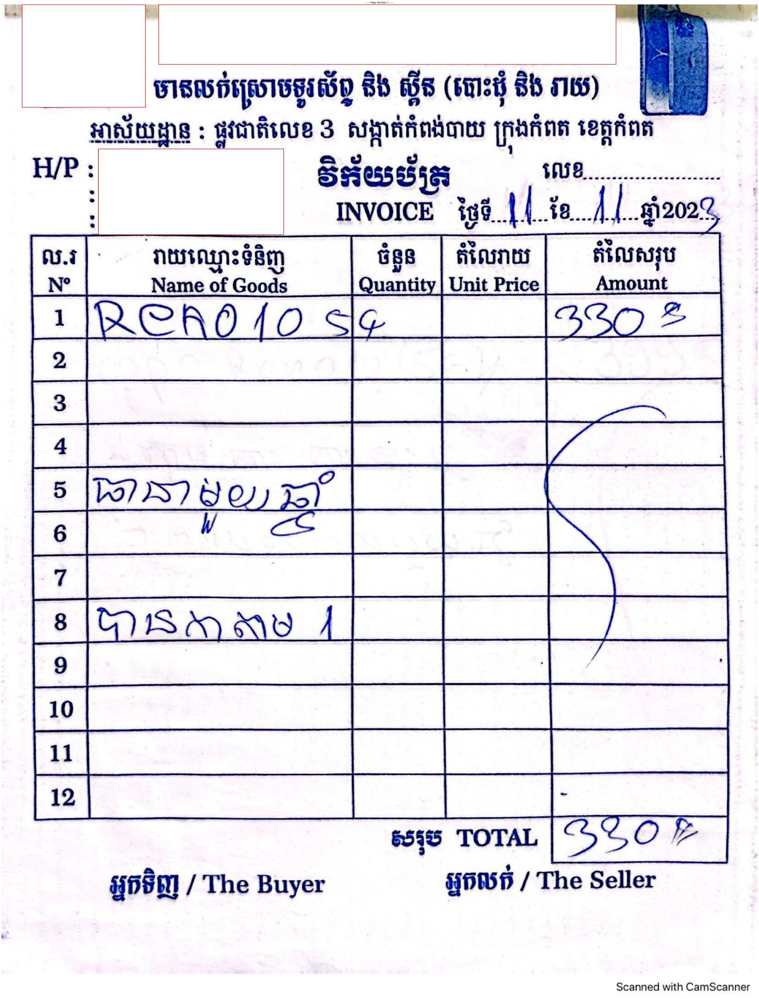

In [7]:
display_images(convert_pdf_to_images)

## PyTesseract

In [11]:
pip install pytesseract


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [12]:
from pytesseract import image_to_string 

In [13]:
def extract_text_with_pytesseract(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        
        image = PIL_Image.open(BytesIO(image_bytes))
        custom_config = r'-l khm+eng --oem 3 --psm 6'
        raw_text = str(image_to_string(image,config=custom_config))
        print(raw_text)
        image_content.append(raw_text)
    
    return "\n".join(image_content)

In [14]:
text_with_pytesseract = extract_text_with_pytesseract(convert_pdf_to_images)

#print(text_with_pytesseract)

= Bi 658 (Csi BE M165)
ADMAUINIS : wiAsnse 3 euNAniney ypHAnA egies
H/P S95 055 05503 weno
: INVOICE wt AO te AJ. 202
N°_| __—NameofGoods__| Quantity | Unit |__ Amount __ |
lOPpo ef™ | eS 7
i] oe ene ES
ssf OID] | No
C5 SDR Alcs SS OT SNE bs EASES
<2 SRESRESORE FE SE
” S SESPATTOS Se SERRE! BN EE
a) SERTPORRERRE SES ES BSE
To) Se sae SURE ER EE a
[3 Ms RECS Se ER a
CS Si: a Se
as ToT
] 995) / The Buyer {{005 /The Seller
_ \
Scanned with CamScanner

| lo 8b 8 (sisi) Sts s165) ly
MAINS : Aifitnse 3 AINAANAMED [AANA tenn
H/P : 5 $5 05505 563 a
INVOICE i3_1( te... 2029
N° | Name ofGoods  _| Quantity} Unit Price| Amount |}.
alReAROfo de | 13302 —
CN (aie Paria BEN SE aks
Cz Sa A We Pe
Ep ee ee a 2 ea
cS ee a
Og es hr es
5 See ee MT A: PG VN
fsltSmmy dt | | /
Th DePrmeee: Sate SE BS
Cesta coe ceeak Obiee IMMER Sie oe.
Gea avaes
ap ae SEO
HSH / ‘The Buyer HHH / The Seller



In [8]:
from vertexai.preview.generative_models import (
    GenerationConfig,
    GenerativeModel,
    Image,
    HarmCategory,
    HarmBlockThreshold,
)

multimodal_model = GenerativeModel("gemini-pro-vision")

In [9]:
def describe_images_gemini(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        print(f"Processing image number : {index}")
        prompt = """You are an Bank assistant reading a bank statement, invoices and processing PDFs for Vattanac Bank in Cambodia.
        Extract all the text from the image. Describe the image, understand the transactions, amount credited and debited, items in the invoices, their price explain in detail. If there are tables and flowcharts, summarize them. If the items are in khmer, translate and summarize in English
        If the information is in a tabular format, such as bank transactions, invoices with list of items, please provide the output in tabular format.
        """
        image_data = Image.from_bytes(image_bytes)
        contents = [image_data, prompt]

        config = GenerationConfig(max_output_tokens=2048,temperature=0.4)

        safety_config = {
            HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: HarmBlockThreshold.BLOCK_NONE,
            HarmCategory.HARM_CATEGORY_HARASSMENT: HarmBlockThreshold.BLOCK_NONE,
            HarmCategory.HARM_CATEGORY_HATE_SPEECH: HarmBlockThreshold.BLOCK_NONE,
            HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: HarmBlockThreshold.BLOCK_NONE,
        }
        try:    
            responses = multimodal_model.generate_content(contents, generation_config=config, stream=False,safety_settings=safety_config)
        except ValueError as e:
            print(f"Something went wrong with the API call: {e}")
            # If the response doesn't contain text, check if the prompt was blocked.
            print(responses.prompt_feedback)
            # Also check the finish reason to see if the response was blocked.
            print(responses.candidates[0].finish_reason)
            # If the finish reason was SAFETY, the safety ratings have more details.
            print(responses.candidates[0].safety_ratings)
            raise Exception(f"Something went wrong with the API call: {e}")

        #messages = ""
        #for response in responses:
        #    print(response.text, end="")
    #     messages = messages + response.text
        msg=responses.text
        print(f"Enriched text: {msg}")
        image_content.append(msg)
    return "\n".join(image_content) 

In [10]:
text_with_gemini = describe_images_gemini(convert_pdf_to_images)

#print(text_with_gemini)

Processing image number : 0
Enriched text:  The image is an invoice from a shop called "Vattanac Bank" dated 10/11/2022.
The invoice has the following items:
1. OPPO A18 - 125$

The total amount of the invoice is 125$.
The invoice is paid by cash.
Processing image number : 1
Enriched text:  The image is an invoice from a shop called "Vattanac Bank" in Cambodia. The invoice is dated 11/11/2023. The invoice has 12 rows. The first column is the item number, the second column is the name of the item, the third column is the quantity of the item, the fourth column is the unit price of the item, and the fifth column is the total price of the item. The total price of the invoice is 3303.


## EasyOCR

In [1]:
from easyocr import Reader

# Load model for the English language
language_reader = Reader(["en"])

URLError: <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:1006)>

In [26]:
def extract_text_with_easyocr(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        
        image = Image.open(BytesIO(image_bytes))
        raw_text = language_reader.readtext(image)
        raw_text = "\n".join([res[1] for res in raw_text])
                       
        image_content.append(raw_text)
    
    return "\n".join(image_content)

In [27]:
text_with_easy_ocr = extract_text_with_easyocr(convert_pdf_to_images)
print(text_with_easy_ocr)

This document provides a quick summary of some of Zoumana's article on Medium
It can be considered as the compilation of his 8O+ articles about Data Science, Machine Learning and
Machine Learning Operations:
Whether YOU
are just getting started
or
youre
an
experienced professional looking to upskill, these
materials can be helpful:
Data Science section covers basic to advanced
overfitting when training computer vision
concepts such as statistics, model evaluation
models.
metrics, SQL queries, NoSQL courses, data
Link: https LInkdinIgDY8ZgVs
visualization Using Tableau and #powerbi, and
many more_
Python section showcases multiple libraries to
Link: https LInkdin/a8zcS_vE
facilitate one's daily life , especially when dealing
with PDF, and Word files when scraping data
MLOps chapter explains how to build and
from the web, and even benchmarking analysis
deploy models Using different strategies such as
to help choose the right data processing tool:.
Docker containers, and GitHub actions on

## PyPDF

In [28]:
#!pip install PyPDF2

In [1]:
from PyPDF2 import PdfReader

In [2]:
def extract_text_with_pyPDF(PDF_File):

    pdf_reader = PdfReader(PDF_File)
    
    raw_text = ''

    for i, page in enumerate(pdf_reader.pages):
        
        text = page.extract_text()
        if text:
            raw_text += text

    return raw_text

In [3]:
text_with_pyPDF = extract_text_with_pyPDF("Sample_notes_6-10.pdf")
print(text_with_pyPDF)

·+ematology is popularly deﬁned as the science of study ofthe blood and various disorders associated with it.·%lood consists of two elementsoPlasma, which is the liquid component.oErythrocytes5%C, /eucocytesW%C andThrombocytesPlatelets They are the solid components.·The solid components are formed as a result of a processcalled +ematopoiesis.·+ematopoiesis results in the formation of the solidcomponents.·)ormation of blood cells occurs in the bone marrow.·A pluripotent stem cell serves as the mother cell in the bonemarrow.·The mother cell is the originator of all blood cells. It has a selfrenewing property and create further progenitors.(U\WKURF\WHV
·6tructure %iconcave, anucleate cells.Organelles absent.·)unction Transport of Oxygen to tissues and Carbon-dioxide to lungs.·/ifespan 20 days in healthy adults,·*lucose is the primary source of energy for erythrocytes.·%oth increase and decrease in erythrocyte count indicates anabnormality.·Normal rangeoMale . - . mil/u/o

## LangChain

In [14]:
pip install ragstack-ai


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [6]:
from langchain.document_loaders.image import UnstructuredImageLoader

def extract_text_with_langchain_image(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        
        image = Image.open(BytesIO(image_bytes))
        loader = UnstructuredImageLoader(image)
        data = loader.load()
        raw_text = data[index].page_content
                       
        image_content.append(raw_text)
    
    return "\n".join(image_content)

In [8]:
text_with_langchain_image = extract_text_with_langchain_image(convert_pdf_to_images)
print(text_with_langchain_image)

TypeError: stat: path should be string, bytes, os.PathLike or integer, not JpegImageFile

In [9]:
from langchain.document_loaders import UnstructuredFileLoader

def extract_text_with_langchain_pdf(pdf_file):
    
    loader = UnstructuredFileLoader(pdf_file)
    documents = loader.load()
    pdf_pages_content = '\n'.join(doc.page_content for doc in documents)
    
    return pdf_pages_content

In [12]:
text_with_langchain_files = extract_text_with_langchain_pdf("Sample_notes_6-10.pdf")
print(text_with_langchain_files)

[nltk_data] Error loading punkt: <urlopen error [SSL:
[nltk_data]     CERTIFICATE_VERIFY_FAILED] certificate verify failed:
[nltk_data]     unable to get local issuer certificate (_ssl.c:1006)>

**********************************************************************
  Resource punkt not found.
  Please use the NLTK Downloader to obtain the resource:

  >>> import nltk
  >>> nltk.download('punkt')
  
  For more information see: https://www.nltk.org/data.html

  Attempted to load tokenizers/punkt/PY3/english.pickle

  Searched in:
    - '/Users/krishnan.narayanaswamy/nltk_data'
    - '/Library/Frameworks/Python.framework/Versions/3.11/nltk_data'
    - '/Library/Frameworks/Python.framework/Versions/3.11/share/nltk_data'
    - '/Library/Frameworks/Python.framework/Versions/3.11/lib/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/local/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/local/lib/nltk_data'
    - ''
********************************************************************

PDFInfoNotInstalledError: Unable to get page count. Is poppler installed and in PATH?